# VAE for MNIST dataset #

In [1]:
# Number of workers for training
num_workers = 4
# Batch size during training
batch_size = 512
# Spatial size of training images
image_size = 28 #64
# Number of channels in the training images. For color images this is 3. For grayscale image (e.g. MNIST) is 1.
nc = 1
# Size of z latent vector (i.e. size of generator input)
nz = 100
# Size of feature maps in generator
ngf = 32
# Size of feature maps in discriminator
ndf = 32
# Number of training epochs
num_epochs = 20
# Learning rate for optimizers
lr = 0.0002
# Beta1 hyperparam for Adam optimizers
beta1 = 0.5
# Beta2 hyperparam for Adam optimizers
beta2 = 0.999
# KLD weight for loss function
kld_weight = 1.e-2

## Step1. Lightning data module for MNIST dataset ##
MNIST data set is normalized to [-1, 1] bacause `Tanh` is used in Generator.

In [2]:
import os
import torch
from torch.utils.data import Dataset

from pytorch_lightning import LightningDataModule
from torch.utils.data import DataLoader, random_split
from torchvision.datasets import MNIST
from torchvision import transforms
from typing import Optional

torch.manual_seed(111)


class MNISTDataset(LightningDataModule):
    def __init__(
        self,
        data_path: str,
        batch_size: int = 128,
        num_workers: int = num_workers
        ):
        super().__init__()
        self.data_dir = data_path
        self.transform = transforms.Compose([transforms.ToTensor(), transforms.Normalize((0.5), (0.5))])
        self.batch_size = batch_size
        self.num_workers = num_workers

    def setup(self, stage: Optional[str] = None) -> None:
        if stage == 'fit' or stage is None:
            full_data = MNIST(os.getcwd(), train=True,  download=True, transform=self.transform)
            self.train_data, self.val_data = random_split(full_data, [50000, 10000])
        if stage == 'test' or stage is None:
            self.test_data  = MNIST(os.getcwd(), train=False, download=True, transform=self.transform)

    def train_dataloader(self):
        return DataLoader(self.train_data, batch_size=self.batch_size, num_workers=self.num_workers)

    def val_dataloader(self):
        return DataLoader(self.val_data, batch_size=self.batch_size, num_workers=self.num_workers)

    def test_dataloader(self):
        return DataLoader(self.test_data, batch_size=self.batch_size, num_workers=self.num_workers)        
    

## Step2. Encoder and Decoder ##

### Encoder ###

from torch import nn

class Encoder(nn.Module):
    def __init__(self):
        super(Encoder, self).__init__()

        self.fc1 = nn.Sequential(
            nn.Linear(784, 256),
            nn.LeakyReLU()
            )
        self.fc2_1 = nn.Linear(256, 128)
        self.fc2_2 = nn.Linear(256, 128)

    def forward(self, x):
        x = self.fc1(x)
        
        return self.fc2_1(x), self.fc2_2(x)

In [3]:
from torch import nn 

class Encoder(nn.Module):
    def __init__(self):
        super(Encoder, self).__init__()

        self.conv1 = nn.Sequential(
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.conv2 = nn.Sequential(
            nn.Conv2d(ndf, ndf*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*2),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.conv3 = nn.Sequential(
            nn.Conv2d(ndf*2, ndf*4, 4, 1, 1, bias=False),
            nn.BatchNorm2d(ndf*4),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.conv4 = nn.Sequential(
            nn.Conv2d(ndf*4, ndf*8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*8),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.conv5_mu = nn.Sequential(
            nn.Conv2d(ndf*8, nz, 3, 1, 0, bias=False)
        )
        self.conv5_var = nn.Sequential(
            nn.Conv2d(ndf*8, nz, 3, 1, 0, bias=False)
        )      
        self.conv5 = nn.Sequential(
            nn.Conv2d(ndf*8, ndf*16, 3, 1, 0, bias=False),
            nn.BatchNorm2d(ndf*16),
            nn.LeakyReLU(0.2, inplace=True)
        )  
        self.fc_mu  = nn.Linear(ndf*16, nz)
        self.fc_var = nn.Linear(ndf*16, nz)

    def forward(self, x):
        #print('enco', x.shape)
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        x = self.conv5(x)
        #print('echo2', x.shape)
        x = x.view(x.size(0), -1)
        #print('echo3', x.shape)

        return [self.fc_mu(x), self.fc_var(x)]
        #return [self.conv5_mu(x), self.conv5_var(x)]


### Decoder ###

class Decoder(nn.Module):
    def __init__(self):
        super(Decoder, self).__init__()

        self.fc1 = nn.Sequential(
            nn.Linear(128, 256),
            nn.LeakyReLU()
            )
        self.fc2 = nn.Sequential(
            nn.Linear(256, 784),
            nn.Tanh()
            )

    def forward(self, z):
        z = self.fc1(z)
        z = self.fc2(z)

        return z
        

In [4]:
class Decoder(nn.Module):
    def __init__(self):
        super(Decoder, self).__init__()
        
        self.linear = nn.Sequential(
            nn.Linear(nz, ngf*16),
            #nn.BatchNorm2d(ngf*16),
            #nn.ReLU(inplace=True)
        )
        self.conv_transpose1 = nn.Sequential(
            nn.BatchNorm2d(ngf*16),
            nn.LeakyReLU(0.2, inplace=True),            
            nn.ConvTranspose2d(ngf*16, ngf*8, 3, 1, 0, bias=False),
            nn.BatchNorm2d(ngf*8),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.conv_transpose2 = nn.Sequential(
            nn.ConvTranspose2d(ngf*8, ngf*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf*4),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.conv_transpose3 = nn.Sequential(
            nn.ConvTranspose2d(ngf*4, ngf*2, 4, 1, 1, bias=False),
            nn.BatchNorm2d(ngf*2),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.conv_transpose4 = nn.Sequential(
            nn.ConvTranspose2d(ngf*2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.conv_transpose5 = nn.Sequential(
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, z):
        #print('deco', z.shape)
        z = self.linear(z)
        #print('deco2', z.shape)
        z = z.view(z.size(0), -1, 1, 1)
        #print('deco3', z.shape)
        z = self.conv_transpose1(z)
        z = self.conv_transpose2(z)
        #print('deco4', z.shape)
        z = self.conv_transpose3(z)
        z = self.conv_transpose4(z)
        z = self.conv_transpose5(z)

        return z

## Step3. VAE ##

In [5]:
from torch.nn import functional as F
from torch import optim
from torch import Tensor
#from torchmetrics.classification import Accuracy
from pytorch_lightning import LightningModule
from torchvision.utils import make_grid
from torchmetrics.image.fid import FrechetInceptionDistance

class VAE(LightningModule):
    def __init__(
        self,
        lr: float = lr,
        b1: float = beta1,
        b2: float = beta2,
        batch_size : int = 128,
        kld_weight: float = kld_weight,
        **kwargs
    ):
        super().__init__()
        self.save_hyperparameters()

        self.encoder = Encoder()
        self.decoder = Decoder()
        self.automatic_optimization = False
        self.training_step_loss = []
        self.validation_z = torch.randn(64, nz)
        self.validation_z_large = torch.randn(int(1e3), nz)
        #self.validation_z = torch.randn(64, nz, 1, 1)
        #self.validation_z_large = torch.randn(int(1e3), nz, 1, 1)        
        self.generated_images = {}
        self.generated_images_large = {}
        self.generated_images_grid = {}
        self.lats = []

    def forward(self, z):
        #print('z', z.shape)
        return self.decoder(z)

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5*logvar)
        eps = torch.randn_like(std)

        return mu + eps * std
    
    def critic(self, fake_image, image, mu, logvar):
        #bce = F.binary_cross_entropy(fake_image, image.view(-1, 784), reduction='sum')
        #kld = -0.5 * torch.sum(1+logvar-mu.pow(2)-logvar.exp())
        #return bce + kld
        mse_loss = F.mse_loss(fake_image, image)#, reduction='sum')
        kld_loss = torch.mean(-0.5 * torch.sum(1 + logvar - mu ** 2 - logvar.exp(), dim = 1), dim = 0)
        kld_weight = self.hparams.kld_weight

        return mse_loss + kld_loss*kld_weight



    def configure_optimizers(self):
        lr = self.hparams.lr
        b1 = self.hparams.b1
        b2 = self.hparams.b2
        #opt = torch.optim.Adam(self.parameters(), lr=lr, betas=(b1,b2))
        opt = torch.optim.Adam(self.parameters())
        
        return opt

    def training_step(self, batch):
        images, _ = batch

        #print('images', images.shape)
        opt = self.optimizers()
        opt.zero_grad()


        mu, logvar = self.encoder(images)
        #print('mu')
        #print(mu)
        #print('logvar')
        #print(logvar)
        z = self.reparameterize(mu, logvar)        
        if self.current_epoch==9:
            self.lats.append(z)
        #print('z')
        #print(z)
        fake_images = self(z)
        #print('fake_images', fake_images.shape)
        #print(fake_images)
        loss = self.critic(fake_images, images, mu, logvar)

        #print('loss',loss.shape)

        self.manual_backward(loss)
        opt.step()

        self.log('loss', loss, prog_bar=True, on_step=True)
        self.training_step_loss.append(loss)

        #return None
        return loss


    def on_train_epoch_end(self) -> None:
        training_epoch_loss = torch.stack(self.training_step_loss).mean()
        self.training_step_loss.clear()
        self.log('epoch_loss', training_epoch_loss, prog_bar=True, on_epoch=True)

        # fake images in a grid

        z = self.validation_z.to(self.device)
        sample_images = self(z)#.view(-1, 1, 28, 28)
        grid = make_grid(sample_images, nrow=8)
        #self.logger.experiment.add_image('generated images', grid, self.current_epoch)
        self.generated_images[self.current_epoch] = sample_images
        self.generated_images_grid[self.current_epoch] = grid

        
        # fake images
        z_large = self.validation_z_large.to(self.device)
        sample_images_large = self(z_large)#.view(-1, 1, 28, 28)
        self.generated_images_large[self.current_epoch] = sample_images_large
        

        '''
        # FID. If you don't need FID metrics, please comment out.
        sample_images_3ch = sample_images.expand(sample_images.size(0), 3, sample_images.size(2), sample_images.size(3)).type(torch.uint8).to(self.device)
        self.fid.update(sample_images_3ch, real=False)
        fid_metrics = self.fid.compute().item()
        self.log('FID', fid_metrics, prog_bar=True, on_epoch=True)
        '''


### VAE2 ###

class VAE2(LightningModule):
    def __init__(self, x_dim=784, h_dim1=512, h_dim2=256, z_dim=2):
        super(VAE2, self).__init__()

        self.save_hyperparameters()
        self.encoder = Encoder()
        self.decoder = Decoder()
        self.automatic_optimization = False
        self.training_step_loss = []
        self.validation_z = torch.randn(64, 2)
        self.validation_z_large = torch.randn(int(1e3), 2)
        self.generated_images = {}
        self.generated_images_large = {}
        self.generated_images_grid = {}
        self.lats = []

        # encoder part
        self.fc1 = nn.Linear(x_dim, h_dim1)
        self.fc2 = nn.Linear(h_dim1, h_dim2)
        self.fc31 = nn.Linear(h_dim2, z_dim)
        self.fc32 = nn.Linear(h_dim2, z_dim)
        # decoder part
        self.fc4 = nn.Linear(z_dim, h_dim2)
        self.fc5 = nn.Linear(h_dim2, h_dim1)
        self.fc6 = nn.Linear(h_dim1, x_dim)
        
    def encoder(self, x):
        h = F.relu(self.fc1(x))
        h = F.relu(self.fc2(h))
        return self.fc31(h), self.fc32(h) # mu, log_var
    
    def sampling(self, mu, log_var):
        std = torch.exp(0.5*log_var)
        eps = torch.randn_like(std)
        return eps.mul(std).add_(mu) # return z sample
        
    def decoder(self, z):
        h = F.relu(self.fc4(z))
        h = F.relu(self.fc5(h))
        #return F.sigmoid(self.fc6(h)) 
        return nn.Tanh()(self.fc6(h))

    def loss_function(self, recon_x, x, mu, log_var):
        #BCE = F.binary_cross_entropy(recon_x, x.view(-1, 784), reduction='sum')
        #KLD = -0.5 * torch.sum(1 + log_var - mu.pow(2) - log_var.exp())

        mse_loss = F.mse_loss(recon_x, x.view(-1, 784))
        kld_loss = torch.mean(-0.5 * torch.sum(1 + log_var - mu ** 2 - log_var.exp(), dim = 1), dim = 0)    
        kld_weight = 2.5e-5

        #return BCE + KLD
        #print('mse/kld', mse_loss, kld_loss)
        return mse_loss + kld_loss*kld_weight


    def configure_optimizers(self):
        opt = torch.optim.Adam(self.parameters())
        
        return opt

    def forward(self, x):
        mu, log_var = self.encoder(x.view(-1, 784))
        z = self.sampling(mu, log_var)
        return self.decoder(z), mu, log_var

    def training_step(self, batch):
        images, _ = batch
        #print('images', images.shape)
        opt = self.optimizers()
        opt.zero_grad()

        fake_images, mu, logvar = self(images)
        #print('fake_images', fake_images.shape)
        #print(fake_images)
        loss = self.loss_function(fake_images, images, mu, logvar)

        #print('loss',loss.shape)

        self.manual_backward(loss)
        opt.step()

        self.log('loss', loss, prog_bar=True, on_step=True)
        self.training_step_loss.append(loss)

        return None
        #return loss

    def on_train_epoch_end(self) -> None:
        training_epoch_loss = torch.stack(self.training_step_loss).mean()
        self.training_step_loss.clear()
        self.log('epoch_loss', training_epoch_loss, prog_bar=True, on_epoch=True)

        # fake images in a grid

        z = self.validation_z.to(self.device)
        sample_images = self.decoder(z).view(-1, 1, 28, 28)
        grid = make_grid(sample_images, nrow=8)
        #self.logger.experiment.add_image('generated images', grid, self.current_epoch)
        self.generated_images[self.current_epoch] = sample_images
        self.generated_images_grid[self.current_epoch] = grid

        
        # fake images
        z_large = self.validation_z_large.to(self.device)
        sample_images_large = self.decoder(z_large).view(-1, 1, 28, 28)
        self.generated_images_large[self.current_epoch] = sample_images_large


## Step4. Logger ##

In [6]:
from pytorch_lightning.loggers import TensorBoardLogger

logger = TensorBoardLogger(save_dir='./tb_logs/', name = 'VAE_light')


#%reload_ext tensorboard
#%tensorboard --logdir=./tb_logs/

## Step5. Build & fit model ##

In [7]:
data = MNISTDataset(data_path = './', batch_size=batch_size)
model = VAE()

In [8]:
from pytorch_lightning import Trainer
from pytorch_lightning.callbacks.progress import TQDMProgressBar

runner = Trainer(max_epochs=num_epochs,
                 #gpus=[0], # comment out if you use 'cpu'
                 accelerator='gpu',  # 'cpu', or 'gpu', 'auto'
                 logger=logger, 
                 callbacks=[TQDMProgressBar(refresh_rate=10)])


runner.fit(model, data)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/hep/shayashi/.pyenv/versions/3.8.6/lib/python3.8/site-packages/pytorch_lightning/trainer/configuration_validator.py:70: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
Missing logger folder: ./tb_logs/VAE_light
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name    | Type    | Params
------------------------------------
0 | encoder | Encoder | 2.4 M 
1 | decoder | Decoder | 1.9 M 
------------------------------------
4.4 M     Trainable params
0         Non-trainable params
4.4 M     Total params
17.423    Total estimated model params size (MB)


Epoch 19: 100%|██████████| 98/98 [00:03<00:00, 25.88it/s, v_num=0, loss=0.192, epoch_loss=0.190]

`Trainer.fit` stopped: `max_epochs=20` reached.


Epoch 19: 100%|██████████| 98/98 [00:04<00:00, 22.34it/s, v_num=0, loss=0.192, epoch_loss=0.190]


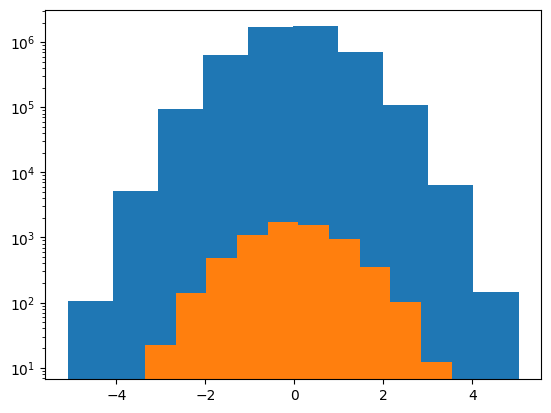

-0.00015036722 1.0009704


In [9]:
import matplotlib.pyplot as plt
import numpy as np

z = model.lats
z = np.vstack([ i.to(torch.device('cpu')).detach().numpy() for i in model.lats]).flatten()
z2 = torch.randn(64,100, 1, 1)
z2 = z2.detach().numpy().flatten()
plt.hist(z)
plt.hist(z2)
plt.yscale('log')
plt.show()
print(z.mean(), z.std())

#print(imgs.shape)

## Step6. Check fake images ##

### Fake images ###

(20, 242, 242)



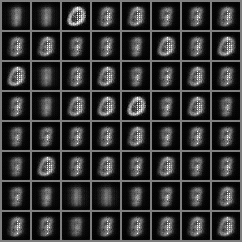
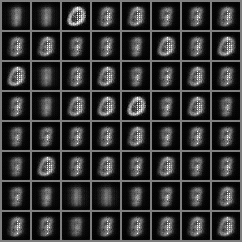
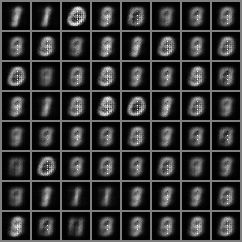
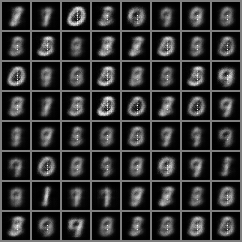
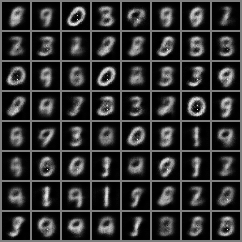
...
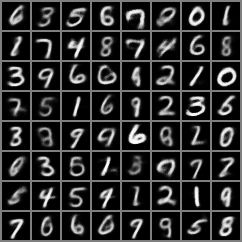
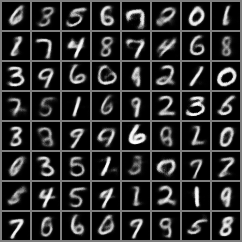
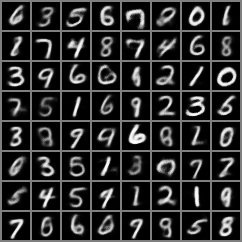
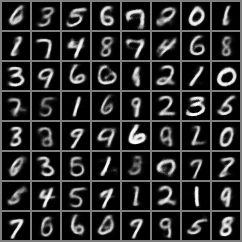
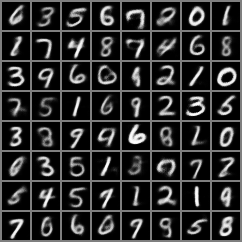

In [10]:
import numpy as np
import plotly.express as px

fake_images_grid = model.generated_images_grid

imgs = np.array([fake_images_grid[i][0].to(torch.device('cpu')).numpy() for i in fake_images_grid])
print(imgs.shape)

fig = px.imshow(imgs, animation_frame=0, binary_string=True)
fig.update_layout(
    autosize=False, 
    width=600, 
    height=800,
    sliders=[{
    "currentvalue": {
        "font": {"size": 14},
        "prefix": "Epoch:",
        "visible": True,
        "xanchor": "left"
    }
    }])

fig.show()

### t-SNE (Real images) ###

In [11]:
from sklearn.manifold import TSNE
import pandas as pd
import numpy as np

tsne = TSNE(n_components=2, random_state=0)



mnist_tmp = MNIST(os.getcwd(), 
                  train=False, 
                  download=True, 
                  transform=transforms.Compose([transforms.ToTensor(), transforms.Normalize((0.5), (0.5))])
                  )


real_mnist_data = np.array([mnist_tmp[i][0].numpy() for i in range(10000)])
#real_mnist_data = mnist_tmp.data.numpy()
real_mnist_data = real_mnist_data.reshape(real_mnist_data.shape[0],-1)
real_mnist_label = mnist_tmp.test_labels.numpy().reshape(-1,1).astype(dtype=str)

tsne_real_mnist = tsne.fit_transform(real_mnist_data)
print(tsne_real_mnist.shape)
df_tsne_real_mnist = pd.concat([pd.DataFrame(real_mnist_label), pd.DataFrame(tsne_real_mnist)], axis=1)
df_tsne_real_mnist.columns = ['label', 'component 1', 'component 2']


/home/hep/shayashi/.pyenv/versions/3.8.6/lib/python3.8/site-packages/torchvision/datasets/mnist.py:70: UserWarning:

test_labels has been renamed targets



(10000, 2)


In [12]:
label_order = [str(i) for i in range(10)]
colors = px.colors.qualitative.Plotly

fig = px.scatter(data_frame = df_tsne_real_mnist, x='component 1', y='component 2', color='label', color_discrete_sequence=colors, category_orders={'label':label_order})

fig.update_layout(title='t-SNE, Real MNIST', width=800, height=800)
fig.show()

### t-SNE (Real+Fake images) ###

In [13]:
fake_images_large = model.generated_images_large

fake_mnist_data = np.array([fake_images_large[i].to(torch.device('cpu')).detach().numpy() for i in fake_images_large])
fake_mnist_data = fake_mnist_data.reshape(fake_mnist_data.shape[0], fake_mnist_data.shape[1], -1)

In [14]:
df_tsne_fake_mnist = pd.DataFrame([])

for i in range(fake_mnist_data.shape[0]):
    print('epoch', i)
    real_fake_data = np.concatenate([real_mnist_data, fake_mnist_data[i]], axis=0)
    real_fake_label = np.concatenate([real_mnist_label, np.full((fake_mnist_data[i].shape[0],1), 'fake')], axis=0)

    tsne_real_fake_mnist = tsne.fit_transform(real_fake_data)

    epoch = np.full((tsne_real_fake_mnist.shape[0], 1), str(i))
    df_tmp = pd.concat([pd.DataFrame(epoch), pd.DataFrame(real_fake_label), pd.DataFrame(tsne_real_fake_mnist)], axis=1)

    df_tsne_fake_mnist = pd.concat([df_tsne_fake_mnist, df_tmp], axis=0)

df_tsne_fake_mnist.columns = ['Epoch', 'label', 'component 1', 'component 2']


epoch 0
epoch 1
epoch 2
epoch 3
epoch 4
epoch 5
epoch 6
epoch 7
epoch 8
epoch 9
epoch 10
epoch 11
epoch 12
epoch 13
epoch 14
epoch 15
epoch 16
epoch 17
epoch 18
epoch 19


In [15]:
label_order.append('fake')
colors.append('black')
fig = px.scatter(data_frame = df_tsne_fake_mnist, x='component 1', y='component 2', animation_frame='Epoch', color='label', color_discrete_sequence=colors, category_orders={'label':label_order})

fig.update_layout(title='t-SNE, Real+Fake MNIST', width=800, height=800)
fig.show()

### Histogram of the values in the image ###

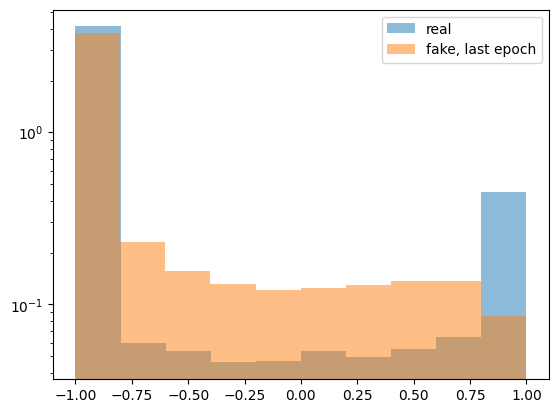

In [16]:
import matplotlib.pyplot as plt
plt.hist(real_mnist_data.flatten(), density=True, alpha=0.5, label='real')
plt.hist(fake_mnist_data[-1].flatten(), density=True, alpha=0.5, label='fake, last epoch')
plt.yscale('log')
plt.legend()
plt.show()